<a href="https://colab.research.google.com/github/Daprosero/Deep-Convolutional-Generative-Adversarial-Network/blob/master/GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#sistema de visión por computador basado en aprendizaje profundo para la detección de objetos sobre imágenes y video.


La deteección de obejtos es una técnica vinculada a la visión artificial y al procesamiento digital de imagenes que busca la extracción, representación y clasificación de cierto tipo de clases en imagenes y videos. La detección de objetos actualmente posee muchas aplicaciones dentro de las cuales se destacan el reconocimiento facial, recuperación de imagenes y seguimineto de objetos.\
El principio básico de la detección de objetos es buscar características propias de una clase, por ejemplo, en un circulo todos los puntos pose una misma distancia a su centro, en un cuadrado se buscan lados con el mismo tamaño y perpendiculares en sus esquinas.\
Para cumplir con el objetivo de Desarrollar un sistema  de visión por computador basado en aprendizaje profundo para la detección de objetos sobre imágenes y videoa partir de la codificación de patrones espacio temporales no estacionarios relevantes, se optó por la implementación de Deep Convolutional Generative Adversarial Networks o DCGAN.




#Generative Adversarial Networks (GAN)

Las GANs es una arquitectura de red neuronal capaz de convertir datos basuras(Ruido) en información relevante(conocimiento). Las GANs utiliza la naturaleza de los adversarios que consiste en implementar un modelo generativo para que compita con un modelo no generativo(Discriminador) para poder lograr objetivos idividuales. Se puede ver este enfrentamiento como el juego de policias y ladrones. los ladrones buscan falsificar dinero cada vez más párecido al real( generador) y los policias de detectar el dinero falso(discriminador).Este modelo llega a un punto en el que es indistinguible el dinero real del falso(50/50) y por ende se puede utilizar las GANs como generadora de datos o detección de datos falsos.\
La estructura general de las GANs es la siguiente:
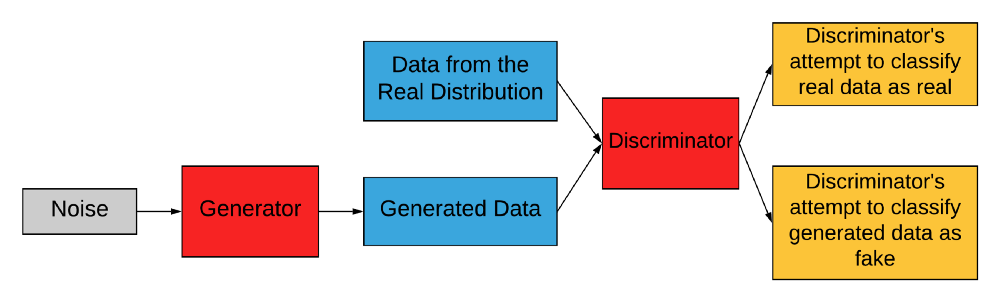
## Ruido
Es la distribución aleatoria que se busca transformar a una distribución deseada, es decir, Las GANs asignan una función estadistica de una distribución a otra.

## Datos de la distribución real
Es la distribución real o deseada, es el objetivo final de las GANs  a la hora de transformar el ruido. En el ejemplo del juego de policias y ladrones este es el conjunto de datos de dinero real con el cual se entrena el modelo.

## Discriminador
El proposito del discriminador es el de clasificar los datos como reales o falsas, en pocas palabras, el discriminador tiene las siguientes funciones.
* Clasificar correctamente los datos reales como reales.
* Clasificar correctamente los datos falsos como falsos.

Podemos ver el discriminador como una métrica de evaluación entrenable que nos indica la calidad del generador. 

## Generador
El generador por medio de una red generativa intenta buscar las tendencias de los datos reales y generar nuevos datos pertencientes a la distribución real. Debido a que este es el apartado principal de las GANs debe penalizarce fuertemente cada vez que los datos generados se encuentren lejos de los reales y más suavemente cuando estos datos nuevos se encuentren cerca de los reales. Se minimiza la penalización a medida que el generador engañe al discriminador.

## Entrenamiento
Por términos de convergencia el entrenamiento del generador y discrminador se deben hacer por separado. Se entrena el discriminador por varias epocas y después el generador, esta secuencia continua de un lado a otro hasta llegar al objetivo. Pero, lo que se quiere es realizar el proceso lo más óptimo posible, es por esto que por cada k pasos óptimos del discriminador se da un paso óptimo en el generador. 
## Función de costo
\begin{equation}
 _{G}^{Min}\rightleftharpoons_{D}^{Max}= E_{x\sim PData(x)}log(D(x))+E_{z\sim P_{z}(z)}log(1-D(G(z))) 
\end{equation}
En donde:
* D(x): Estiumación de los discriminadores de la probabilidad de que la instancia `x` de los datos.
* $E_{x}$: Valor esperado sobre todas las instancias de los datos reales.
* G(z): Salida del generador cuando se le da un ruido `z`
* D(G(z)): Estimación discriminadora de la probabilidad de que una instancia falsa(G(z)) sea real.
* $E_{z}$ valor esperadosobre todas las entradas aleatorias al generador,En efecto, es el valor esperado sobre todas las instansias falsas generadas G(z).


Esta perdida se conoce como la pérdida Minmax, en donde el generador busca minimizar y el discrimizar busca maximizar la función. En muchas ocaciones se puede modificar esta función para que ocurra lo contrario, es decir, el generador maximice la función y el discriminador la minimice. Esta última modificación se hace debido a que en las primera epocas el discriminador facilmente clasifica los datos reales de los falsos saturando la función de costo, como resultado se tendrá un modelo mas robusto al inicio del entrenamiento y mas flexible al final.

# Deep Convolutional Generative Adversarial Networks (DCGAN)
los DCGAN son la "versión" de las GANs para imagenes. Esta estructura utiliza principalmente las redes neuronales profundas para generar imagenes a partir del ruido, lo que quiere decir  que esta versión utiliza una red generadora para crear nuevos datos y una red discriminatoria para evaluar el rendimiento del generador. 

## Generador
El generador se basa principalmente en capas convolucionales transpuestas que da como resultado el proceso inverso de las capas convolucionales. Esta sección se encargada de desconvolucioanr el ruido y llevarlo a la distribución deseada. Un ejemplo de este proceso es aplicar un kernel 3x3 sobre una imagen 2x2 con bordes de cero 2x2 (imagen 6x6) y extraer una imagen 4x4

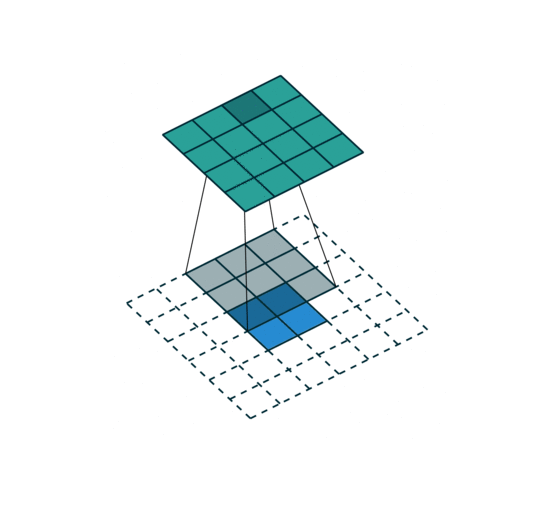

## Discriminador 
El discriminador es simplemente un clasificador binario compuesto por capas convolucionales. La salida de estas capas convolucionales es una salida con la probabilidad de que la imagen sea real o falsa.

## Perdida
Definiremos la perdida como la penalización debido a la equivocación en el funcionamiento de alguno de los dos modelos. En el caso del generador la penalización ocurre cuando el discriminador clasifica las imagenes generadas como falsas. De forma contraria el discriminador debe predecir las salidas y clasificarlas de manera correcta, lo que se traduce en clasificar las imagenes falsas como falsas y las reales como reales, de lo contrario este modelo será penalizado.


#Implementación

Para poder realizar la implemntación de una DCGAN se buscaron las bases de datos más utilizadas en Machine Learning para probar y comparar los resultados de investigaciónes debido a su amplia literatura. Estos conjuntos de datos son MNIST y CIFAR-10.

En la seguiente sección se realizará un ejemplo detallado utilizando la bas de datos MNIST, esto con el objetivo de explicar y afianzar los conociminetos observados en la sección anteriror.
De manera similar se creará un modelo para la utlización de la base de datos CIFAR-10 con su respectiva explicación a las modificaciones relizadas a la estructura del modelo anterior

## MNIST
La MNIST (Modified National Institute of Standards and Technology database) es una base de datos de diígitos escrits a mano. Esta base de datos consta de 60.000 muetras para entrenamiento y 10.000 para evaluación

En la siguiente celda se  importarán e instalará todas las librerias requeridas en el documento y se carga la base de datos MNIST

In [1]:
# To generate GIFs
!pip install -q imageio
!pip install -q git+https://github.com/tensorflow/docs
#importación de librerías
import glob
import imageio
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
from tensorflow.keras import layers
import time
import tensorflow as tf
from IPython import display
#Se carga la base de datos
(train_images, train_labels), (_, _) = tf.keras.datasets.mnist.load_data()
train_images.shape

(60000, 28, 28)

Se normaliza los valores de la base de datos para que sus valores oscilen entre 1 y -1, esto se hace debido a que las imagenes se encuentran entre 0 y 255.

In [2]:
train_images = train_images.reshape(train_images.shape[0], 28, 28, 1).astype('float32')
# Normaliza las imagenes entre [-1, 1]
train_images = (train_images - 127.5) / 127.5 


In [3]:
train_images.shape


(60000, 28, 28, 1)

Se crea una nueva base de datos con lotes aleatorios de tamaño 256

In [4]:
BUFFER_SIZE = 60000
BATCH_SIZE = 64
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

### Generador
Para el generador se usará capas `tf.keras.layers.Conv2DTranspose` la cual genera una imagen a partir de una semilla aleatoria que se muestrea varias veces hasta alcanzar el tamaño de 28x28x1


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 12544)             1254400   
_________________________________________________________________
batch_normalization (BatchNo (None, 12544)             50176     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 12544)             0         
_________________________________________________________________
reshape (Reshape)            (None, 7, 7, 256)         0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 7, 7, 128)         819200    
_________________________________________________________________
batch_normalization_1 (Batch (None, 7, 7, 128)         512       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 7, 7, 128)         0

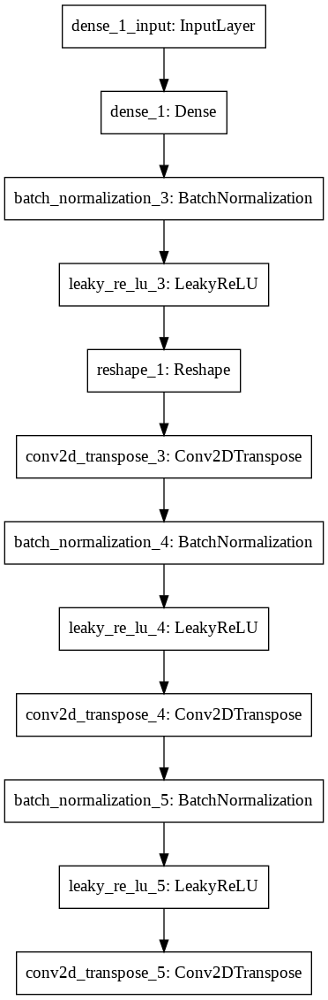

In [5]:
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(7*7*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.001))
    model.add(layers.Reshape((7, 7, 256)))
    assert model.output_shape == (None, 7, 7, 256) # Note: None is the batch size
    model.add(layers.Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
    assert model.output_shape == (None, 7, 7, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.001))
    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 14, 14, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.001))
    model.add(layers.Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 28, 28, 1)
    return model 
make_generator_model().summary()
tf.keras.utils.plot_model(make_generator_model())   

Se utiliza el generador aun no entrenado para viualizar la imagen creada por el modelo  

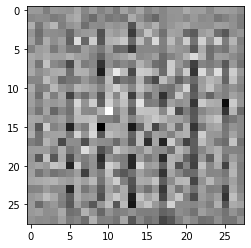

In [6]:
generator = make_generator_model()
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)
plt.imshow(generated_image[0, :, :, 0], cmap='gray')

### Discriminador
 es un clasificador de imagenes basado en redes neuronales convolucionales que devuelve valores positivos para imagenes reales(1) y negativos para imagenes falsas(-1)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 14, 14, 32)        832       
_________________________________________________________________
leaky_re_lu_9 (LeakyReLU)    (None, 14, 14, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 7, 7, 64)          51264     
_________________________________________________________________
batch_normalization_9 (Batch (None, 7, 7, 64)          256       
_________________________________________________________________
leaky_re_lu_10 (LeakyReLU)   (None, 7, 7, 64)          0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 7, 7, 64)         

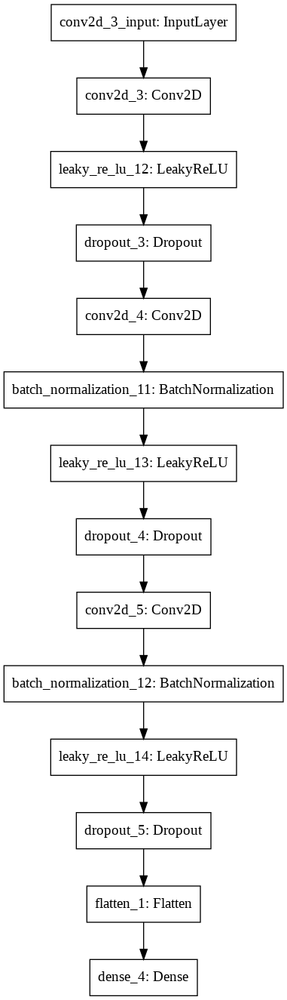

In [7]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(32, (5, 5), strides=(2, 2), padding='same',input_shape=[28, 28, 1]))
    model.add(layers.LeakyReLU(alpha=0.01))
    model.add(layers.Dropout(0.3))
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.01))
    model.add(layers.Dropout(0.3))
    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU(alpha=0.01))
    model.add(layers.Dropout(0.3))
    model.add(layers.Flatten())
    model.add(layers.Dense(1))
    return model
make_discriminator_model().summary()
tf.keras.utils.plot_model(make_discriminator_model())    

Se utiliza el discriminador no entrenado para observar su funcionamiento 

In [8]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print (decision)

tf.Tensor([[-0.00137252]], shape=(1, 1), dtype=float32)


### Perdidad del discriminador
Esta función mide o cuantifica la eficiencia del discriminador a la hora de predecir las imagenes como falsas o reales, para ello genera una matriz de unos con las predicciones de las imagenes reales y una matriz de ceros con las predicciones de las imagenes falsas.

In [9]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

### Perdida del generador
Similar que en la perdida del discrminador, la perdida del generador cuantifica la eficiencia del generador para crear las imagenes, es decir, que tan bien le fue al generador engañando al discriminador. Para esto crea una matriz con las decisiones del clasificador, si el generador funciona correctamente el resultad será una matriz de 1.

In [10]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

### Optimizadores
Debido a que el entrenamiento se hace por separado, se debe crear un optimizador para cada red.

`Nota:` Como se miró en la parte inicial de este documento el entrenamiento de las dos redes es en conjunto. Por cada `K` pasos del discriminador un paso del generador.En donde si bien se entrenan por separado, los resultados de cada uno influyen en los siguientes pasos del otro. 

In [11]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

### Checkpoint
En muchas ocasiones por diversos factores como tiempo libre de conexión en un entorno, desconexión,etc, es necesario realizar un autoguardado de nuestro progreso para no volver a inicar desde el principio siempre que ocurra un imprevisto. Para solucionar este inconveniente se añade la siguinete celda y se adiciona al entrenamiento 

In [12]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,discriminator=discriminator)

### Ciclo de entrenamiento
En esta sección se establece las epocas de entrenamiento y la semilla aleatoria para iniciar la generación de imagenes asi como tambien el número de imagenes a generar. La semilla se guarda a lo largo de todo el entrenamiento para reducir costo computacional.

In [13]:
EPOCHS = 60
noise_dim = 100
num_examples_to_generate = 16
seed = tf.random.normal([num_examples_to_generate, noise_dim])


A continuación se establecen las dos funciones que realizan el entrenamiento de los dos modelos. En general. la siguiente celda recibe la semmilla generada aleatoriamente `seed` y la utiliza para generar un imagen, esta imagen pasa por el discriminador quien la clasifica como real o falsa.

la perdidad es calculada para cada uno de estos modelos y utilizada por el gradiente para recalcular su valor, actualizar al generador y discriminador en cada epoca. 

In [14]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

def train(dataset, epochs):
    for epoch in range(epochs):
        start = time.time()
        for image_batch in dataset:
            train_step(image_batch)
    # Produce images for the GIF as we go
        display.clear_output(wait=True)
        generate_and_save_images(generator,epoch + 1,seed,discriminator)
    # Save the model every 15 epochs
        if (epoch + 1) % 15 == 0:
            checkpoint.save(file_prefix = checkpoint_prefix)
        print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))
    #Generate after the final epoch
    display.clear_output(wait=True)
    generate_and_save_images(generator,epochs,seed,discriminator)

En el siguiente apartado se realiza la generación de imagenes para cada modelo creado en cada epoca. Esta función recibe el model, la epoca y la semilla inicial. En el arreglo `predictions` guarda las 16 imagenes generadas y las muestra en una figura de 4x4. Al final del entrenamineto tendremos 100(`EPOCHS`) imagenes con  cada imagen mostrando las 16 imagenes generadas en cada epoca   

In [15]:
from sklearn.metrics import accuracy_score
def generate_and_save_images(model, epoch, test_input,discriminator):
    # Notice `training` is set to False.
    # This is so all layers run in inference mode (batchnorm).
    predictions = model(test_input, training=False)
    predictions_c=discriminator(predictions,training=False)
    predictions_c=((np.array(predictions_c)>0)*1.0).reshape(-1,)
    print('precisión: ')
    print(accuracy_score(np.ones(predictions_c.shape),predictions_c))
    fig = plt.figure(figsize=(4,4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
        plt.axis('off')
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

### Entrenamineto
Finalmente se realiza el llamado a la función `train()` para realizar el entrenamiento simultaneo del generador y el discriminador.

precisión: 
0.5625


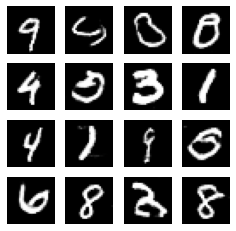

In [16]:
train(train_dataset,EPOCHS)
#checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

### Resultados
La función display_imag() es la encargada de mostrar la imagen de cierta epoca generada en el proceso de entrenamiento.

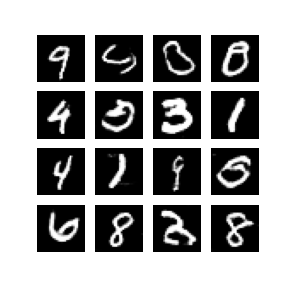

In [17]:
def display_image(epoch_no):
  return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))
display_image(EPOCHS)

Por último se utilizan todas las imagenes generadas y guardadas en el proceso de entrenamiento para crear un gif y asi poder observar el avance de los resultados a lo largo de todo el entrenamiento.


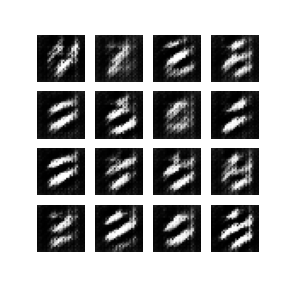

In [18]:
anim_file = 'dcgan.gif'
with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)
  image = imageio.imread(filename)
  writer.append_data(image)
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

## CIFAR-10
El conjunto de datos CIFAR-10 consta de de 60.000 imagenes en color de 32x32x3 correspondientes a 10 clases, cuenta 6.000 imagens por cada clase. Este conjunto de datos cuenta con 50.000 imagenes dedicadas a entrenamiento y 1.000 a evaluación. 

El modelo realizada en esta sección es similar al utilizado en la base de datos MNIST, con la excepción de que la entrada del discriminador pasa del tamaño 28x28x1 al tamaño 32x32x3 y la salida del generador cambia al tamaño 32x32x3, asi mismo, la complejidad de las redes ha aumentado debido a la mayor complejidad de la base de datos en comparación con la anterior.

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_8 (Dense)              (None, 32768)             3276800   
_________________________________________________________________
batch_normalization_19 (Batc (None, 32768)             131072    
_________________________________________________________________
leaky_re_lu_26 (LeakyReLU)   (None, 32768)             0         
_________________________________________________________________
reshape_4 (Reshape)          (None, 8, 8, 512)         0         
_________________________________________________________________
conv2d_transpose_13 (Conv2DT (None, 8, 8, 256)         3276800   
_________________________________________________________________
batch_normalization_20 (Batc (None, 8, 8, 256)         1024      
_________________________________________________________________
leaky_re_lu_27 (LeakyReLU)   (None, 8, 8, 256)        

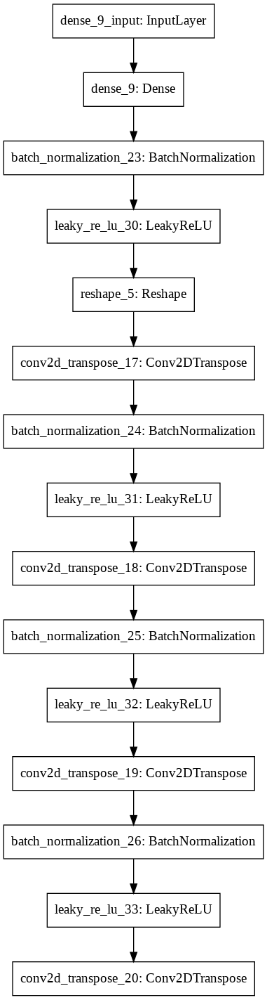

In [19]:
(train_images, train_labels), (_, _) = tf.keras.datasets.cifar10.load_data()
train_images = (train_images - 127.5) / 127.5 
BUFFER_SIZE = 50000
BATCH_SIZE=128
train_dataset = tf.data.Dataset.from_tensor_slices(train_images).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
def make_generator_model():
    generator = tf.keras.models.Sequential()
    generator.add(layers.Dense(8*8*512, use_bias=False, input_shape=(100,)))
    generator.add(layers.BatchNormalization())
    generator.add(layers.LeakyReLU(alpha=0.01))
    generator.add(layers.Reshape((8, 8, 512)))
    assert generator.output_shape == (None, 8, 8, 512)
    generator.add(layers.Conv2DTranspose(filters=256, kernel_size=(5, 5),strides=(1, 1), padding='same',kernel_initializer=tf.keras.initializers.TruncatedNormal(stddev=0.02), use_bias=False))
    assert generator.output_shape == (None, 8, 8, 256)
    generator.add(layers.BatchNormalization())
    generator.add(layers.LeakyReLU(alpha=0.01))
    generator.add(layers.Conv2DTranspose(filters=128, kernel_size=(5, 5), padding='same',kernel_initializer=tf.keras.initializers.TruncatedNormal(stddev=0.02), use_bias=False))
    assert generator.output_shape == (None, 8, 8, 128)
    generator.add(layers.BatchNormalization())
    generator.add(layers.LeakyReLU(alpha=0.01))
    #generator.add(layers.Conv2DTranspose(filters=128, kernel_size=(5, 5), padding='same', use_bias=False))
    #assert generator.output_shape == (None, 8, 8, 128)
    #generator.add(layers.BatchNormalization())
    #generator.add(layers.LeakyReLU(alpha=0.01))
    generator.add(layers.Conv2DTranspose(filters=64, kernel_size=(5, 5), strides=(2, 2), padding='same',kernel_initializer=tf.keras.initializers.TruncatedNormal(stddev=0.02),use_bias=False))
    assert generator.output_shape == (None, 16, 16, 64)
    generator.add(layers.BatchNormalization())
    generator.add(layers.LeakyReLU(alpha=0.01))
    generator.add(layers.Conv2DTranspose(filters=3, kernel_size=(5, 5), strides=(2, 2), padding='same',kernel_initializer=tf.keras.initializers.TruncatedNormal(stddev=0.02), use_bias=False, activation='tanh'))
    assert generator.output_shape == (None, 32, 32, 3)
    return generator
def make_discriminator_model():
    discriminator = tf.keras.models.Sequential()
    discriminator.add(layers.Conv2D(filters=128, kernel_size=(5, 5), strides=(2, 2),kernel_initializer=tf.keras.initializers.TruncatedNormal(stddev=0.02),padding='same', input_shape=[32, 32, 3]))
    discriminator.add(layers.LeakyReLU(alpha=0.01))
    discriminator.add(layers.Dropout(0.3))
    discriminator.add(layers.Conv2D(filters=256, kernel_size=(5, 5), strides=(2, 2),kernel_initializer=tf.keras.initializers.TruncatedNormal(stddev=0.02), padding='same'))
    discriminator.add(layers.LeakyReLU(alpha=0.01))
    discriminator.add(layers.Dropout(0.3))
    discriminator.add(layers.Conv2D(filters=256, kernel_size=(5, 5), strides=(2, 2),kernel_initializer=tf.keras.initializers.TruncatedNormal(stddev=0.02), padding='same'))
    discriminator.add(layers.LeakyReLU(alpha=0.01))
    discriminator.add(layers.Dropout(0.3))
    discriminator.add(layers.Conv2D(filters=128, kernel_size=(5, 5), strides=(2, 2),kernel_initializer=tf.keras.initializers.TruncatedNormal(stddev=0.02), padding='same'))
    discriminator.add(layers.LeakyReLU(alpha=0.01))
    discriminator.add(layers.Dropout(0.3))
    discriminator.add(layers.Flatten())
    discriminator.add(layers.Dense(1))
    return discriminator
discriminator=make_discriminator_model()
generator=make_generator_model()    
make_generator_model().summary()
tf.keras.utils.plot_model(make_generator_model())

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_13 (Conv2D)           (None, 16, 16, 128)       9728      
_________________________________________________________________
leaky_re_lu_34 (LeakyReLU)   (None, 16, 16, 128)       0         
_________________________________________________________________
dropout_13 (Dropout)         (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 8, 8, 256)         819456    
_________________________________________________________________
leaky_re_lu_35 (LeakyReLU)   (None, 8, 8, 256)         0         
_________________________________________________________________
dropout_14 (Dropout)         (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 4, 4, 256)       

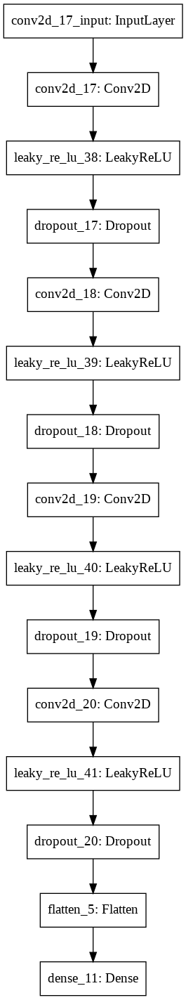

In [20]:
make_discriminator_model().summary()
tf.keras.utils.plot_model(make_discriminator_model())    

Se modifica la función `generate_and_save_images()` para generar y guardar imagenes RGB. Para esto simplemente basta con dividir a `(predictions[i, :, :, :] * 127.5 + 127.5)` entre 255

In [21]:
def generate_and_save_images(model, epoch, test_input,discriminator):
    predictions = model(test_input, training=False)
    predictions_c=discriminator(predictions,training=False)
    predictions_c=((np.array(predictions_c)>0)*1.0).reshape(-1,)
    print('precisión: ')
    print(accuracy_score(np.ones(predictions_c.shape),predictions_c))
    fig = plt.figure(figsize=(4,4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow((predictions[i, :, :, :] * 127.5 + 127.5)/255)
        plt.axis('off')
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

Se vuelve a compilar la función `train_step()` para esta base de datos. 

In [22]:
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)
        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

### Entrenaminto del modelo
Al igual que en la sección anterior se entrena simultaneamente al discriminador y al generador por medio de la función `train()`  

precisión: 
0.0625


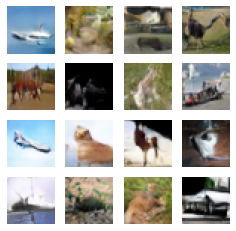

In [23]:
EPOCHS=600
train(train_dataset,EPOCHS)

### Visualización
Por ultimo se muestran los resultados obtenidos en la última epoca y el GIF con los resultados a lo largo de todo el entrenamineto.

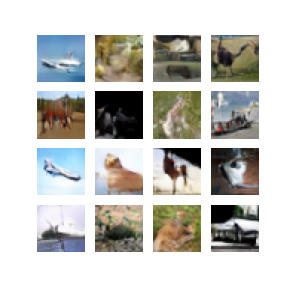

In [24]:
display_image(EPOCHS)



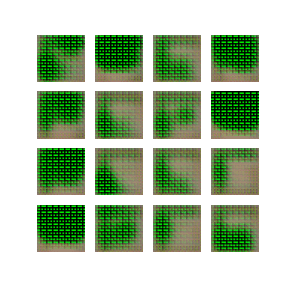

In [25]:
anim_file = 'dcgan.gif'
with imageio.get_writer(anim_file, mode='I') as writer:

    filenames = glob.glob('image*.png')
    filenames = sorted(filenames)
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)
import tensorflow_docs.vis.embed as embed
embed.embed_file(anim_file)

# Resultado de las DCGAN
En la implementación anterior se utilizaron las GANs para generar datos propios a dos distribuciones:
##MNIST 
como se pudo ver en la sección correspondiente a esta base de datos los números generados por la DCGAN son relativamente buenos para haberse implementaado con dos redes simples. Se observó como a partir de la epoca 40 los resultados oscilaron entre una presición de 85% y 60% siendo mas estable al rededor del 75%, esta oscilación es normal debido a al lucha continua del generador y discriminador.
 ## CIFAR-10
 Debido a la mayor complejidad de esta base de datos se obtó por la implementación de un DCGAN más completa en comparación con la construida en la anteriro base de datos. Las epocas necesarias para tener resultados relativamente buenos fueron ## teniendo valores oscilantes entre ## y ## siendo más estable en ##.

En la implementación anterior se utilizó `sklearn.metrics.accuracy_score` para comparar un vector de unos de tamaño 16x1 con la predicción de las imagenes generadas, el cual en el caso ideal es un vector de unos de tamaño 16x1.


```
    predictions = model(test_input, training=False)
    predictions_c=discriminator(predictions,training=False)
    predictions_c=((np.array(predictions_c)>0)*1.0).reshape(-1,)
    print('precisión: ')
    print(accuracy_score(np.ones(predictions_c.shape),predictions_c))
```
 Como resultado, en cada epoca se mostrá que tanto el generador esta engañando al discriminador